# Pipeline de Preprocesamiento para Detección de Objetos - Dataset TACO

Este notebook visualiza y valida el pipeline de preprocesamiento diseñado para el dataset TACO.

## Objetivos:
1. Cargar imágenes y anotaciones del dataset TACO
2. Aplicar transformaciones paso a paso
3. Visualizar resultados ANTES y DESPUÉS con bounding boxes
4. Validar que las transformaciones de bboxes son correctas
5. Probar con casos extremos (brillo, contraste, ruido)

## 1. Importar Librerías

In [18]:
import sys
sys.path.append('../../src')

import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path
from PIL import Image
import random
from typing import List, Tuple, Dict

# Import our preprocessing module
from data.preprocessing import (
    get_transforms,
    TACOPreprocessor,
    convert_coco_to_pascal,
    validate_bbox
)


## 2. Configuración y Carga del Dataset

In [19]:
# Paths
dataset_path = Path('../../data/raw/datasets/kneroma/tacotrashdataset/versions/3/data')
annotations_file = dataset_path / 'annotations.json'

# Load annotations
with open(annotations_file, 'r') as f:
    data = json.load(f)

print(f"Total de imágenes: {len(data['images'])}")
print(f"Total de anotaciones: {len(data['annotations'])}")
print(f"Total de categorías: {len(data['categories'])}")

# Create category id to name mapping
id_to_name = {cat['id']: cat['name'] for cat in data['categories']}
id_to_supercategory = {cat['id']: cat['supercategory'] for cat in data['categories']}

print(" Dataset TACO cargado exitosamente")

Total de imágenes: 1500
Total de anotaciones: 4784
Total de categorías: 60
 Dataset TACO cargado exitosamente


## 3. Funciones de Utilidad para Visualización

In [20]:
def load_image_and_annotations(image_id: int, data: dict, dataset_path: Path) -> Tuple[np.ndarray, List, List]:
    """
    Load an image and its annotations from the dataset.
    
    Returns:
        image: RGB numpy array
        bboxes: List of bboxes in Pascal VOC format [x_min, y_min, x_max, y_max]
        labels: List of category IDs
    """
    # Find image info
    img_info = next(img for img in data['images'] if img['id'] == image_id)
    img_path = dataset_path / img_info['file_name']
    
    # Load image
    image = cv2.imread(str(img_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Get annotations for this image
    annotations = [ann for ann in data['annotations'] if ann['image_id'] == image_id]
    
    bboxes = []
    labels = []
    
    for ann in annotations:
        # Convert COCO bbox to Pascal VOC format
        bbox_coco = ann['bbox']  # [x, y, width, height]
        bbox_pascal = convert_coco_to_pascal(
            bbox_coco,
            img_info['width'],
            img_info['height']
        )
        
        # Validate bbox
        if validate_bbox(bbox_pascal, img_info['width'], img_info['height']):
            bboxes.append(bbox_pascal)
            labels.append(ann['category_id'])
    
    return image, bboxes, labels, img_info


def draw_bboxes(
    image: np.ndarray,
    bboxes: List[List[float]],
    labels: List[int],
    id_to_name: dict,
    ax=None,
    color='red',
    linewidth=2
):
    """
    Draw bounding boxes on an image.
    """
    if ax is None:
        fig, ax = plt.subplots(1, figsize=(12, 8))
    
    ax.imshow(image)
    
    for bbox, label in zip(bboxes, labels):
        x_min, y_min, x_max, y_max = bbox
        width = x_max - x_min
        height = y_max - y_min
        
        # Draw rectangle
        rect = patches.Rectangle(
            (x_min, y_min),
            width,
            height,
            linewidth=linewidth,
            edgecolor=color,
            facecolor='none'
        )
        ax.add_patch(rect)
        
        # Add label
        label_name = id_to_name.get(label, f'ID:{label}')
        ax.text(
            x_min,
            y_min - 5,
            label_name,
            color=color,
            fontsize=8,
            bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.7)
        )
    
    ax.axis('off')
    return ax


def visualize_before_after(
    original_image: np.ndarray,
    original_bboxes: List,
    original_labels: List,
    transformed_image: np.ndarray,
    transformed_bboxes: List,
    transformed_labels: List,
    id_to_name: dict,
    title: str = "Comparación Antes/Después"
):
    """
    Visualize original and transformed images side by side.
    """
    fig, axes = plt.subplots(1, 2, figsize=(20, 20))
    
    # Original
    draw_bboxes(original_image, original_bboxes, original_labels, id_to_name, ax=axes[0], color='green')
    axes[0].set_title(f'ANTES - OriginalShape: {original_image.shape}', fontsize=14, fontweight='bold')
    
    # Transformed (denormalize if needed)
    if transformed_image.dtype == np.float32 or transformed_image.dtype == np.float64:
        # Denormalize (reverse ImageNet normalization)
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        display_image = transformed_image * std + mean
        display_image = np.clip(display_image, 0, 1)
    else:
        display_image = transformed_image / 255.0
    
    draw_bboxes(display_image, transformed_bboxes, transformed_labels, id_to_name, ax=axes[1], color='red')
    axes[1].set_title(f'DESPUÉS - TransformadoShape: {transformed_image.shape}', fontsize=14, fontweight='bold')
    
    plt.suptitle(title, fontsize=16, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.show()

print(" Funciones de utilidad definidas")

 Funciones de utilidad definidas


## 4. Ejemplo 1: Imagen con Múltiples Objetos

In [21]:
# Select an image with multiple objects
# Let's find one with 5+ objects
from collections import Counter

image_annotation_counts = Counter(ann['image_id'] for ann in data['annotations'])
images_with_many_objects = [img_id for img_id, count in image_annotation_counts.items() if 5 <= count <= 10]

# Pick a random one
random.seed(42)
example_image_id = random.choice(images_with_many_objects)

print(f"Imagen seleccionada ID: {example_image_id}")
print(f"Número de objetos: {image_annotation_counts[example_image_id]}")

# Load image and annotations
image, bboxes, labels, img_info = load_image_and_annotations(example_image_id, data, dataset_path)

print(f"Imagen: {img_info['file_name']}")
print(f"Dimensiones originales: {image.shape}")
print(f"Bounding boxes cargados: {len(bboxes)}")
print(f"Categorías: {[id_to_name[label] for label in labels]}")

Imagen seleccionada ID: 1280
Número de objetos: 7
Imagen: batch_7/000122.JPG
Dimensiones originales: (2448, 3264, 3)
Bounding boxes cargados: 7
Categorías: ['Plastic film', 'Other plastic', 'Unlabeled litter', 'Other plastic', 'Other plastic', 'Other plastic', 'Other plastic']


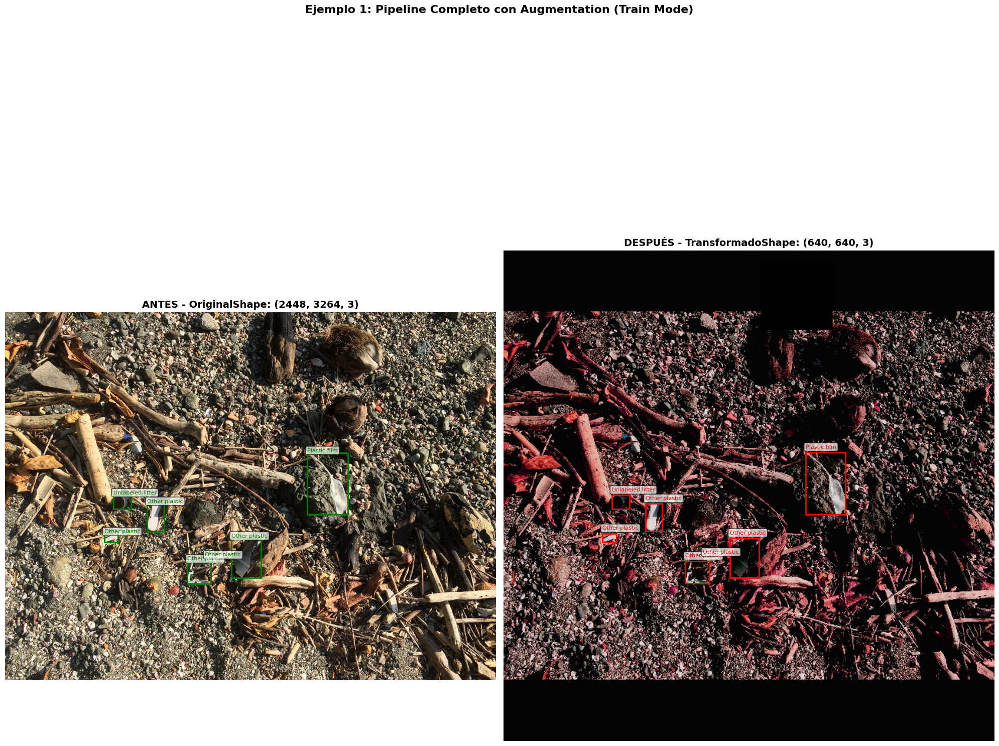

In [22]:
# Create preprocessor for training mode (with augmentation)
preprocessor_train = TACOPreprocessor(mode='train', img_size=640, normalize=True)

# Apply transformation
result = preprocessor_train(image.copy(), bboxes.copy(), labels.copy())

# Visualize
visualize_before_after(
    image,
    bboxes,
    labels,
    result['image'],
    result['bboxes'],
    result['labels'],
    id_to_name,
    title="Ejemplo 1: Pipeline Completo con Augmentation (Train Mode)"
)

## 5. Ejemplo 2: Modo Validación (Sin Augmentation)

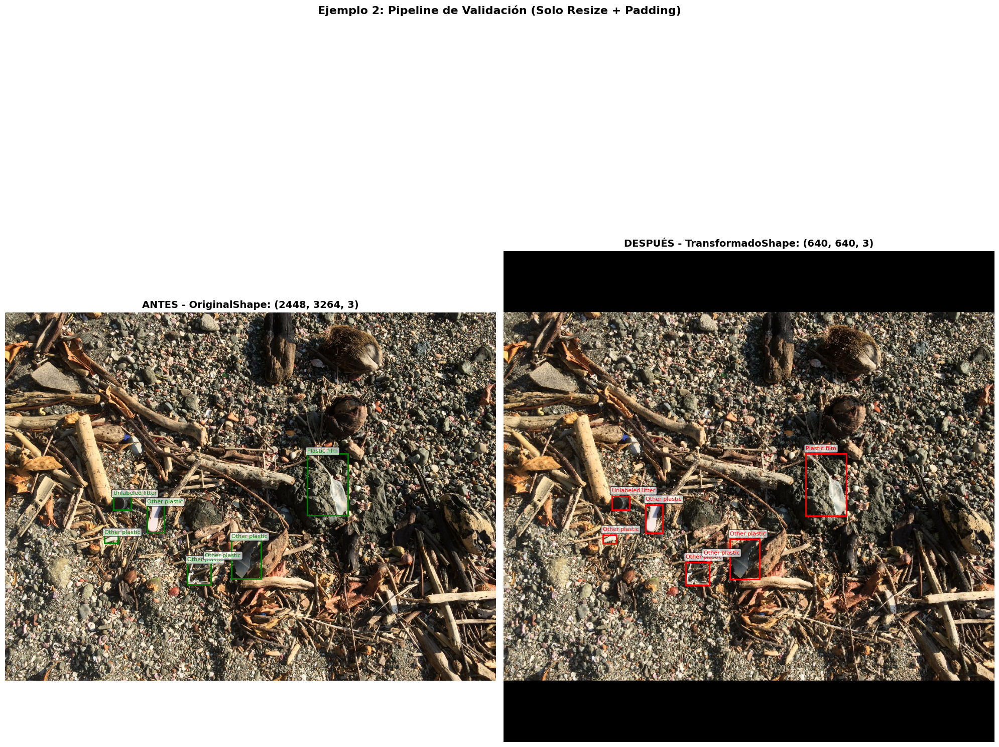

In [23]:
# Create preprocessor for validation mode (no augmentation)
preprocessor_val = TACOPreprocessor(mode='val', img_size=640, normalize=True)

# Apply transformation
result_val = preprocessor_val(image.copy(), bboxes.copy(), labels.copy())

# Visualize
visualize_before_after(
    image,
    bboxes,
    labels,
    result_val['image'],
    result_val['bboxes'],
    result_val['labels'],
    id_to_name,
    title="Ejemplo 2: Pipeline de Validación (Solo Resize + Padding)"
)

## 6. Visualización Paso a Paso del Pipeline

Veamos cada transformación individualmente para entender su efecto.

/tmp/ipykernel_103604/3583259951.py:8: UserWarning: Argument(s) 'value' are not valid for transform PadIfNeeded
  A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0)
/tmp/ipykernel_103604/3583259951.py:13: UserWarning: Argument(s) 'value' are not valid for transform PadIfNeeded
  A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0),
/tmp/ipykernel_103604/3583259951.py:19: UserWarning: Argument(s) 'value' are not valid for transform PadIfNeeded
  A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0),


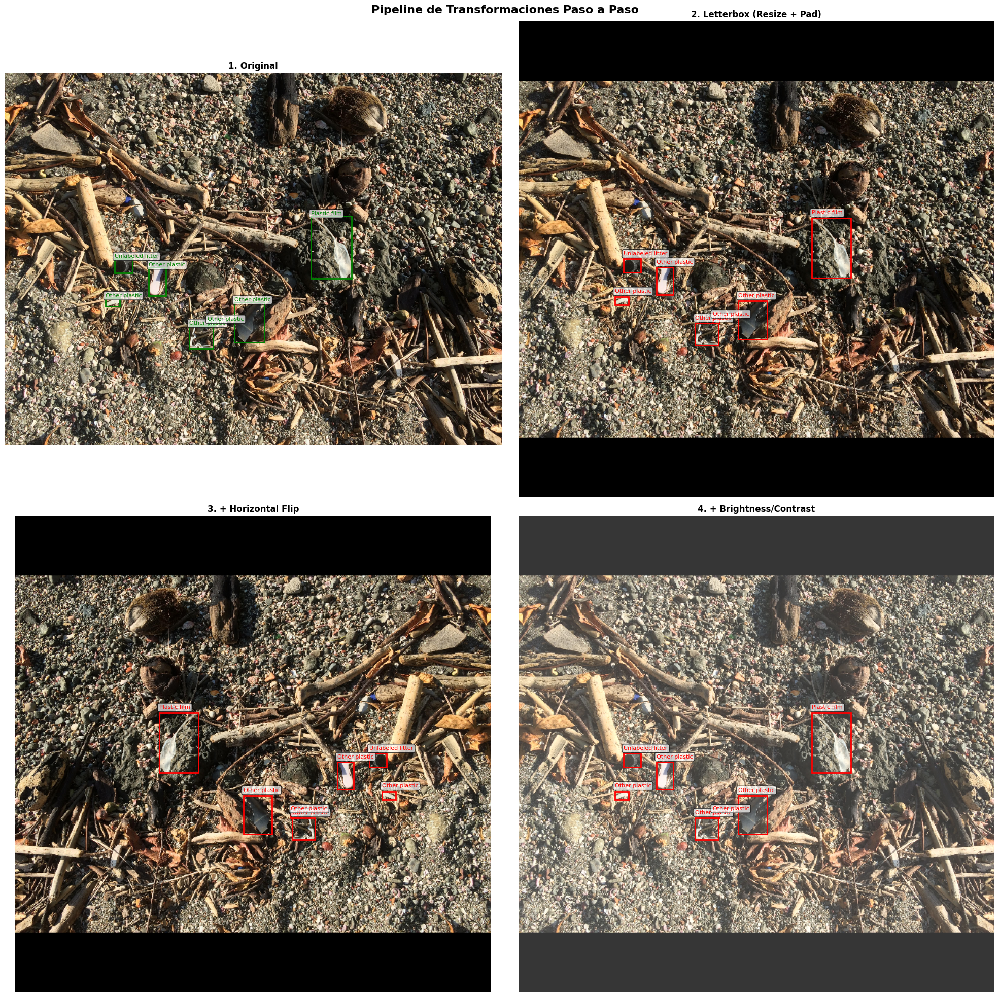

In [24]:
import albumentations as A

# Define individual transforms
steps = [
    ("1. Original", None),
    ("2. Letterbox (Resize + Pad)", A.Compose([
        A.LongestMaxSize(max_size=640, p=1.0),
        A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'], min_area=25, min_visibility=0.3))),
    
    ("3. + Horizontal Flip", A.Compose([
        A.LongestMaxSize(max_size=640, p=1.0),
        A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0),
        A.HorizontalFlip(p=1.0)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'], min_area=25, min_visibility=0.3))),
    
    ("4. + Brightness/Contrast", A.Compose([
        A.LongestMaxSize(max_size=640, p=1.0),
        A.PadIfNeeded(min_height=640, min_width=640, border_mode=cv2.BORDER_CONSTANT, value=(114, 114, 114), p=1.0),
        A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=1.0)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels'], min_area=25, min_visibility=0.3))),
]

# Apply and visualize
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
axes = axes.flatten()

for idx, (title, transform) in enumerate(steps):
    if transform is None:
        # Original
        draw_bboxes(image, bboxes, labels, id_to_name, ax=axes[idx], color='green', linewidth=2)
    else:
        # Apply transform
        result = transform(image=image.copy(), bboxes=bboxes.copy(), labels=labels.copy())
        draw_bboxes(result['image'], result['bboxes'], result['labels'], id_to_name, ax=axes[idx], color='red', linewidth=2)
    
    axes[idx].set_title(title, fontsize=12, fontweight='bold')

plt.suptitle('Pipeline de Transformaciones Paso a Paso', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

## 7. Casos Extremos: Imágenes con Calidad Variable

Basándonos en las estadísticas del dataset, vamos a probar el pipeline con casos extremos.

Cargando casos extremos...
Caso: Brillo MUY BAJO (22.78)
Archivo: batch_7/000031.JPG


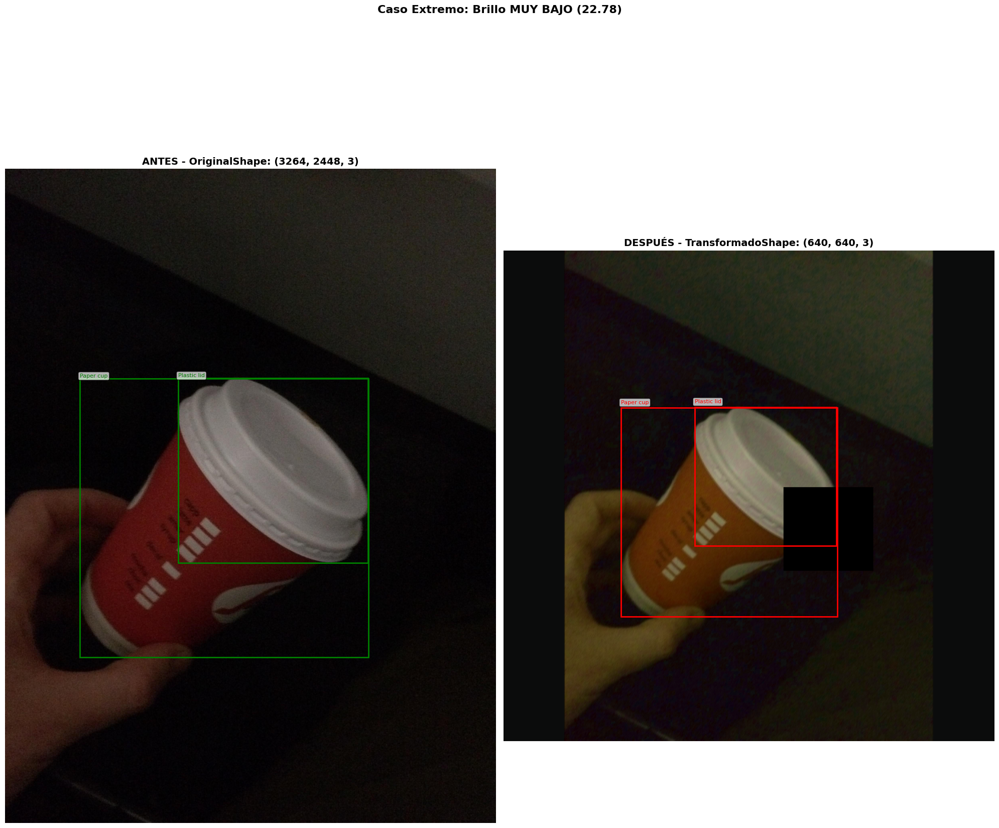

Caso: Brillo MUY ALTO (207.55)
Archivo: batch_3/IMG_4868.JPG


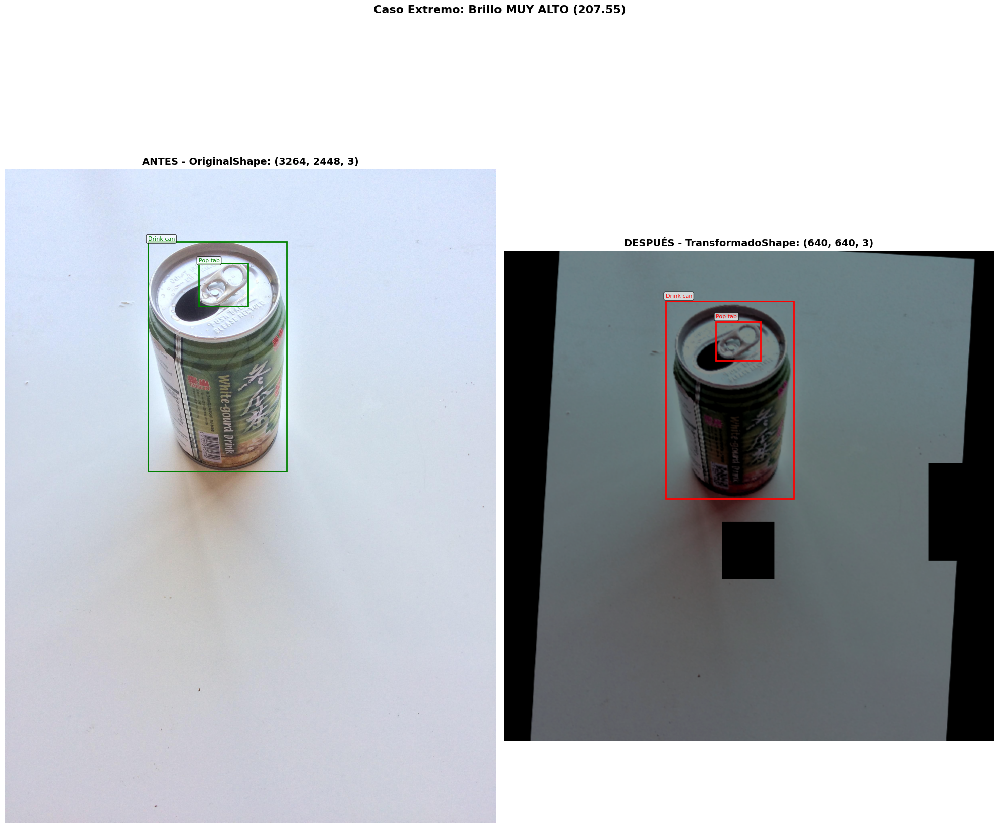

In [25]:
# From dataset_statistics.txt, we know the extreme cases:
extreme_cases = [
    ('batch_7/000031.JPG', 'Brillo MUY BAJO (22.78)'),
    ('batch_3/IMG_4868.JPG', 'Brillo MUY ALTO (207.55)'),
    ('batch_11/000088.jpg', 'Contraste MUY BAJO (15.08)'),
    ('batch_15/000070.jpg', 'Ruido MUY ALTO (14236.24)'),
]

print("Cargando casos extremos...")

for filename, description in extreme_cases[:2]:  # Test first 2
    # Find image in dataset
    img_info = next((img for img in data['images'] if img['file_name'] == filename), None)
    
    if img_info:
        print(f"{'='*60}")
        print(f"Caso: {description}")
        print(f"Archivo: {filename}")
        print(f"{'='*60}")
        
        image_ext, bboxes_ext, labels_ext, _ = load_image_and_annotations(img_info['id'], data, dataset_path)
        
        # Apply preprocessing
        result_ext = preprocessor_train(image_ext.copy(), bboxes_ext.copy(), labels_ext.copy())
        
        # Visualize
        visualize_before_after(
            image_ext,
            bboxes_ext,
            labels_ext,
            result_ext['image'],
            result_ext['bboxes'],
            result_ext['labels'],
            id_to_name,
            title=f"Caso Extremo: {description}"
        )
    else:
        print(f"⚠️ No se encontró la imagen: {filename}")

## 8. Validación: Múltiples Ejecuciones del Pipeline

Dado que el pipeline incluye augmentation aleatoria, ejecutémoslo múltiples veces para ver la variabilidad.

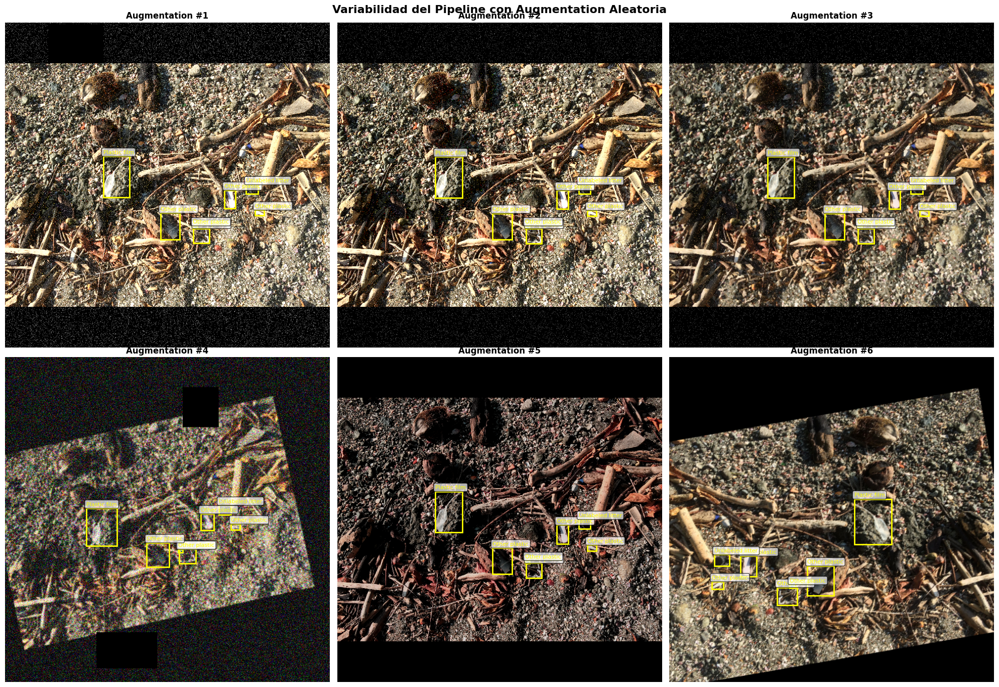

In [26]:
# Apply pipeline multiple times to the same image
fig, axes = plt.subplots(2, 3, figsize=(20, 14))
axes = axes.flatten()

for idx in range(6):
    result = preprocessor_train(image.copy(), bboxes.copy(), labels.copy())
    
    # Denormalize for visualization
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    display_image = result['image'] * std + mean
    display_image = np.clip(display_image, 0, 1)
    
    draw_bboxes(display_image, result['bboxes'], result['labels'], id_to_name, ax=axes[idx], color='yellow', linewidth=2)
    axes[idx].set_title(f'Augmentation #{idx+1}', fontsize=12, fontweight='bold')

plt.suptitle('Variabilidad del Pipeline con Augmentation Aleatoria', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

## 9. Estadísticas de Transformación de Bounding Boxes

Ejecutando pipeline 100 veces para análisis estadístico...
ESTADÍSTICAS DE TRANSFORMACIÓN
Bounding boxes originales: 7
Bboxes retenidos (promedio): 6.98
Bboxes retenidos (min-max): 5 - 7
Tasa de retención: 99.7%
Área original (promedio): 32187.43 px²
Área transformada (promedio): 1360.69 px²
ESTADÍSTICAS DE TRANSFORMACIÓN
Bounding boxes originales: 7
Bboxes retenidos (promedio): 6.98
Bboxes retenidos (min-max): 5 - 7
Tasa de retención: 99.7%
Área original (promedio): 32187.43 px²
Área transformada (promedio): 1360.69 px²


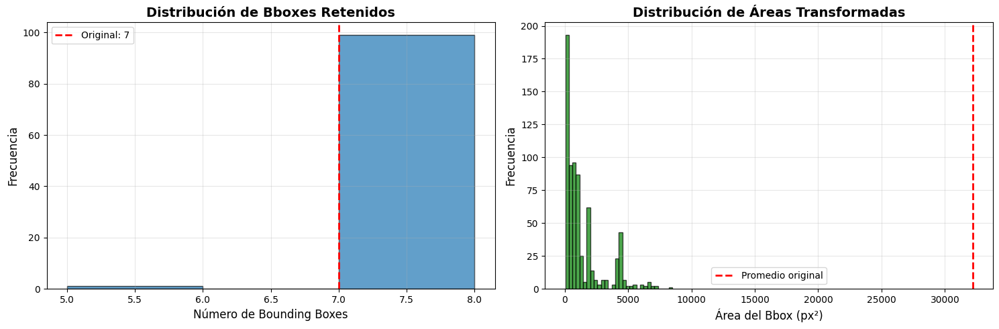

 Análisis completado


In [27]:
# Analyze bbox transformations across multiple augmentations
n_runs = 100
bbox_counts = []
bbox_area_changes = []

original_areas = [(bbox[2] - bbox[0]) * (bbox[3] - bbox[1]) for bbox in bboxes]
original_count = len(bboxes)

print(f"Ejecutando pipeline {n_runs} veces para análisis estadístico...")

for i in range(n_runs):
    result = preprocessor_train(image.copy(), bboxes.copy(), labels.copy())
    bbox_counts.append(len(result['bboxes']))
    
    if len(result['bboxes']) > 0:
        transformed_areas = [(bbox[2] - bbox[0]) * (bbox[3] - bbox[1]) for bbox in result['bboxes']]
        bbox_area_changes.extend(transformed_areas)

# Statistics
print("=" * 60)
print("ESTADÍSTICAS DE TRANSFORMACIÓN")
print("=" * 60)
print(f"Bounding boxes originales: {original_count}")
print(f"Bboxes retenidos (promedio): {np.mean(bbox_counts):.2f}")
print(f"Bboxes retenidos (min-max): {min(bbox_counts)} - {max(bbox_counts)}")
print(f"Tasa de retención: {np.mean(bbox_counts) / original_count * 100:.1f}%")

print(f"Área original (promedio): {np.mean(original_areas):.2f} px²")
print(f"Área transformada (promedio): {np.mean(bbox_area_changes):.2f} px²")

# Visualization
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Bbox count distribution
axes[0].hist(bbox_counts, bins=range(min(bbox_counts), max(bbox_counts) + 2), edgecolor='black', alpha=0.7)
axes[0].axvline(original_count, color='red', linestyle='--', linewidth=2, label=f'Original: {original_count}')
axes[0].set_xlabel('Número de Bounding Boxes', fontsize=12)
axes[0].set_ylabel('Frecuencia', fontsize=12)
axes[0].set_title('Distribución de Bboxes Retenidos', fontsize=14, fontweight='bold')
axes[0].legend()
axes[0].grid(alpha=0.3)

# Area distribution
axes[1].hist(bbox_area_changes, bins=30, edgecolor='black', alpha=0.7, color='green')
axes[1].axvline(np.mean(original_areas), color='red', linestyle='--', linewidth=2, label=f'Promedio original')
axes[1].set_xlabel('Área del Bbox (px²)', fontsize=12)
axes[1].set_ylabel('Frecuencia', fontsize=12)
axes[1].set_title('Distribución de Áreas Transformadas', fontsize=14, fontweight='bold')
axes[1].legend()
axes[1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

print(" Análisis completado")

## 10. Resumen y Conclusiones

### Transformaciones Aplicadas:

1. **Letterboxing (Resize + Padding)**:
   - Mantiene la relación de aspecto original
   - Redimensiona el lado más largo a 640px
   - Añade padding gris (114, 114, 114) para crear imagen cuadrada
   - Bounding boxes escalados y trasladados correctamente

2. **Augmentations Geométricas** (solo en train):
   - Horizontal Flip (p=0.5)
   - ShiftScaleRotate (p=0.5)
   - CoarseDropout para simular oclusiones (p=0.3)
   - Bboxes transformados automáticamente por Albumentations

3. **Augmentations Fotométricas** (solo en train):
   - RandomBrightnessContrast: Aborda variabilidad de iluminación
   - Blur (Motion/Median/Gaussian): Simula desenfoque
   - GaussNoise/ISONoise: Hace el modelo robusto al ruido
   - HueSaturationValue: Variación de color
   - Bboxes no afectados (solo transformaciones de píxeles)

4. **Normalización**:
   - ImageNet mean/std para transfer learning
   - Valores en rango normalizado para estabilidad en entrenamiento

### Validaciones:

- Bounding boxes permanecen alineados con los objetos después de transformaciones
- Pipeline maneja correctamente casos extremos (brillo bajo/alto, ruido)
- Modo validación produce resultados determinísticos
- Modo entrenamiento genera diversidad suficiente
- Bboxes pequeños o fuera de límites se filtran automáticamente (min_area=25, min_visibility=0.3)

### Uso en Entrenamiento:

```python
from data.preprocessing import TACOPreprocessor

# En tu Dataset class
self.preprocessor = TACOPreprocessor(mode='train', img_size=640)

# En __getitem__
result = self.preprocessor(image, bboxes, labels)
return result['image'], result['bboxes'], result['labels']
```